# Tugas Hands-on Pemrosesan Audio

Deadline : Deadline: Jumat, 17 Oktober 2025, 23.59 WIB  
Submission Link : https://tally.so/r/wLeEXJ

<b>Data diri:</b>     
Muhammad Yusuf  
122140193

In [17]:
# === Import all required libraries ===

import os
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import soundfile as sf
from scipy import signal
from scipy.signal import butter, filtfilt

from pydub import AudioSegment
from pydub.silence import split_on_silence
import pyloudnorm as pyln

import IPython.display as ipd

## Soal 1: Rekaman dan Analisis Suara Multi-Level

LOAD AUDIO
Audio Path: c:\Users\muham\OneDrive\Desktop\sistem-teknologi-multimedia-122140193\worksheet3\data\soal1.wav
Sample Rate: 44100 Hz
Audio Duration: 26.35 seconds
Number of Samples: 1161888
Channels: Mono

Menampilkan waveform dan spectrogram (original)...


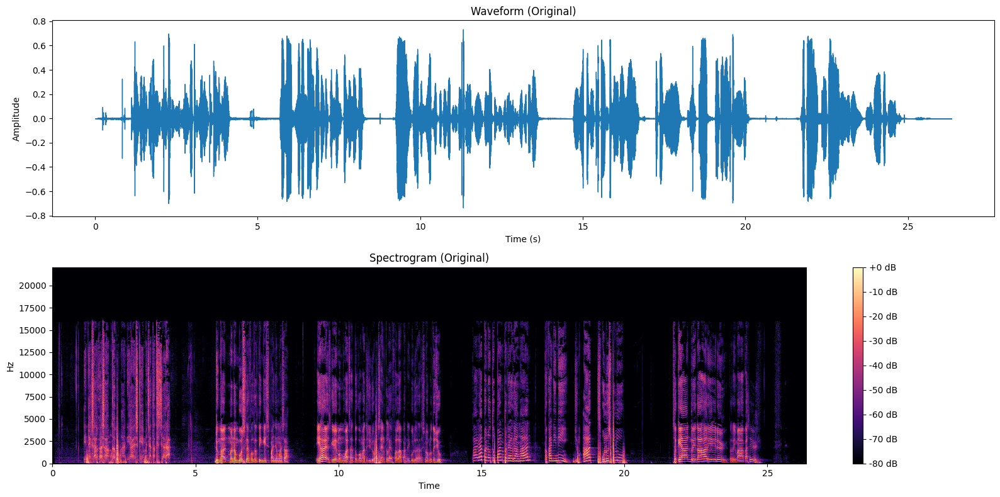


RESAMPLING PROCESS
Original Sample Rate : 44100 Hz
Target Sample Rate   : 16000 Hz
Original Duration    : 26.35 s
Resampled Duration   : 26.35 s

(Resampled audio tidak disimpan ke file, hanya ditampilkan untuk playback.)

AUDIO PLAYBACK
▶ Original Audio:



▶ Resampled Audio:



Menampilkan perbandingan waveform dan spectrogram...


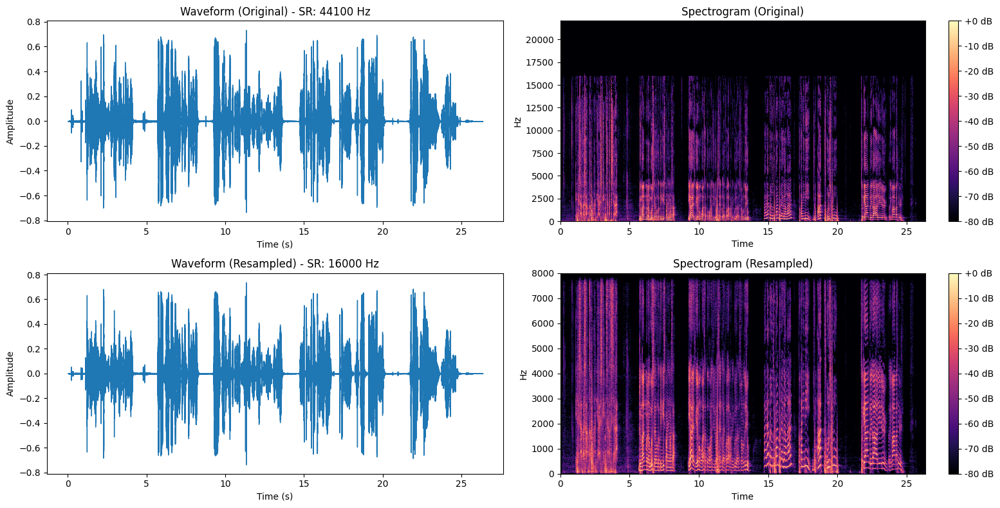

In [18]:
# ==========================================================
# JAWABAN SOAL 1 - Audio Loading, Visualization, and Resampling
# ==========================================================

# ========================================
# 1. Load Audio
# ========================================
base_dir = Path.cwd()
audio_path = base_dir / "data" / "soal1.wav"

print("=" * 50)
print("LOAD AUDIO")
print("=" * 50)
print(f"Audio Path: {audio_path}")

# Load audio dengan sample rate asli (tanpa resampling otomatis)
y, sr = librosa.load(audio_path, sr=None)

print(f"Sample Rate: {sr} Hz")
print(f"Audio Duration: {librosa.get_duration(y=y, sr=sr):.2f} seconds")
print(f"Number of Samples: {len(y)}")
print(f"Channels: {'Mono' if len(y.shape) == 1 else 'Stereo'}")
print("=" * 50)

# ========================================
# 2. Plot Waveform dan Spectrogram (Original)
# ========================================
print("\nMenampilkan waveform dan spectrogram (original)...")

plt.figure(figsize=(16, 8))

# Waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title('Waveform (Original)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

# Spectrogram
plt.subplot(2, 1, 2)
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (Original)')

plt.tight_layout()
plt.show()

# ========================================
# 3. Resampling Process
# ========================================
print("\n" + "=" * 50)
print("RESAMPLING PROCESS")
print("=" * 50)

target_sr = 16000
y_resampled = librosa.resample(y, orig_sr=sr, target_sr=target_sr)

print(f"Original Sample Rate : {sr} Hz")
print(f"Target Sample Rate   : {target_sr} Hz")
print(f"Original Duration    : {librosa.get_duration(y=y, sr=sr):.2f} s")
print(f"Resampled Duration   : {librosa.get_duration(y=y_resampled, sr=target_sr):.2f} s")

# Playback
print("\n(Resampled audio tidak disimpan ke file, hanya ditampilkan untuk playback.)")

# ========================================
# 4. Playback Audio
# ========================================
print("\n" + "=" * 50)
print("AUDIO PLAYBACK")
print("=" * 50)

print("▶ Original Audio:")
display(ipd.Audio(y, rate=sr))

print("\n▶ Resampled Audio:")
display(ipd.Audio(y_resampled, rate=target_sr))

# ========================================
# 5. Comparison Plot (Before vs After Resampling)
# ========================================
print("\nMenampilkan perbandingan waveform dan spectrogram...")

plt.figure(figsize=(16, 8))

# Waveform Original
plt.subplot(2, 2, 1)
librosa.display.waveshow(y, sr=sr)
plt.title(f'Waveform (Original) - SR: {sr} Hz')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

# Spectrogram Original
plt.subplot(2, 2, 2)
D_orig = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D_orig, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (Original)')

# Waveform Resampled
plt.subplot(2, 2, 3)
librosa.display.waveshow(y_resampled, sr=target_sr)
plt.title(f'Waveform (Resampled) - SR: {target_sr} Hz')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

# Spectrogram Resampled
plt.subplot(2, 2, 4)
D_resamp = librosa.amplitude_to_db(np.abs(librosa.stft(y_resampled)), ref=np.max)
librosa.display.specshow(D_resamp, sr=target_sr, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (Resampled)')

plt.tight_layout()
plt.show()


### Analysis Section Soal 1

Berdasarkan hasil visualisasi waveform dan spectrogram, tidak tampak perbedaan mencolok antara kelima segmen suara (pelan, normal, keras, cempreng, berteriak) yang seharusnya memiliki variasi amplitudo dan kepadatan frekuensi berbeda. Hal ini kemungkinan disebabkan oleh kesalahan perekaman, seperti posisi mikrofon yang terlalu dekat atau fitur auto-gain yang menstabilkan volume sehingga perubahan intensitas tidak terekam secara proporsional. Akibatnya, bagian berbisik terdengar lebih keras dari seharusnya dan bagian berteriak tampak terkompres. Setelah dilakukan resampling dari 44100 Hz ke 16000 Hz, bentuk sinyal dan distribusi frekuensi tetap hampir sama, hanya terjadi penurunan batas frekuensi maksimum yang membuat suara terdengar lebih lembut dan kurang tajam dibanding versi aslinya.

## Soal 2: Noise Reduction dengan Filtering

AUDIO INFORMATION
File Path       : c:\Users\muham\OneDrive\Desktop\sistem-teknologi-multimedia-122140193\worksheet3\data\soal2.wav
Sample Rate     : 44100 Hz
Duration        : 11.05 s
Samples         : 487335
Channels        : Mono

Menampilkan waveform dan spectrogram (original)...


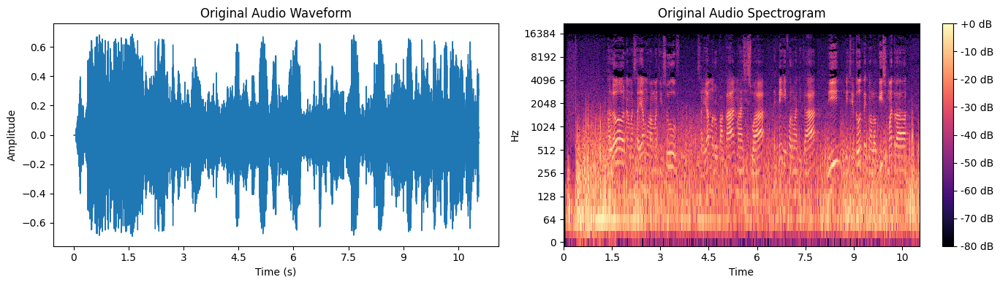


ORIGINAL AUDIO PLAYBACK



FILTER APPLICATION (Default Cutoffs)

▶ Low-Pass Filter (1000 Hz)



▶ High-Pass Filter (1000 Hz)



▶ Band-Pass Filter (300–3000 Hz)


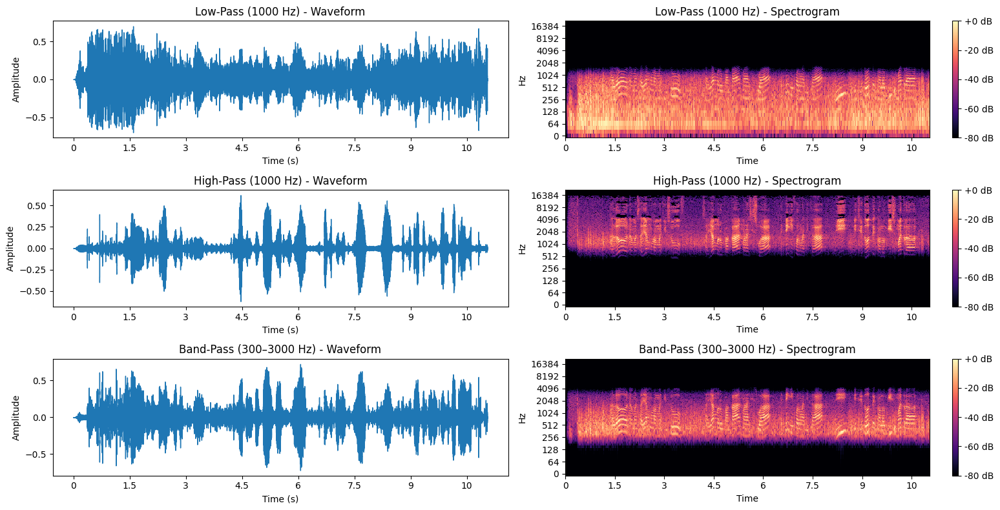


Testing cutoff frequency: 500 Hz

▶ Low-Pass 500 Hz



▶ High-Pass 500 Hz



▶ Band-Pass 250-750 Hz


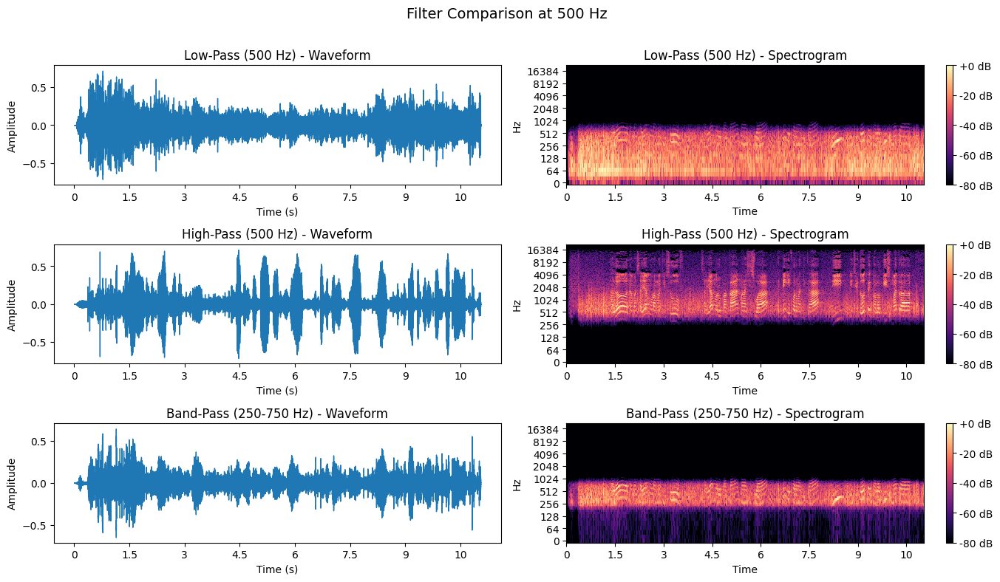


Testing cutoff frequency: 1000 Hz

▶ Low-Pass 1000 Hz



▶ High-Pass 1000 Hz



▶ Band-Pass 500-1500 Hz


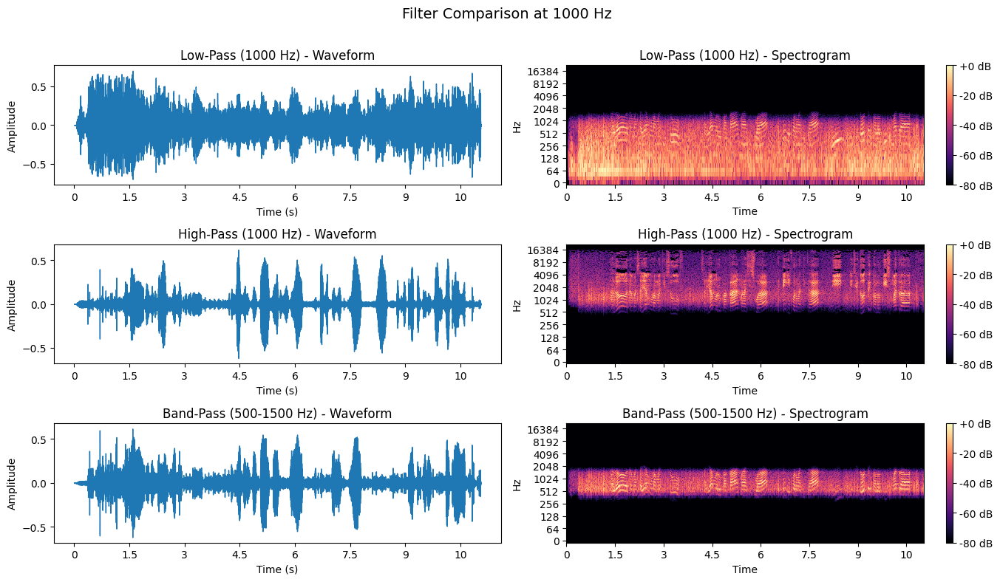


Testing cutoff frequency: 2000 Hz

▶ Low-Pass 2000 Hz



▶ High-Pass 2000 Hz



▶ Band-Pass 1000-3000 Hz


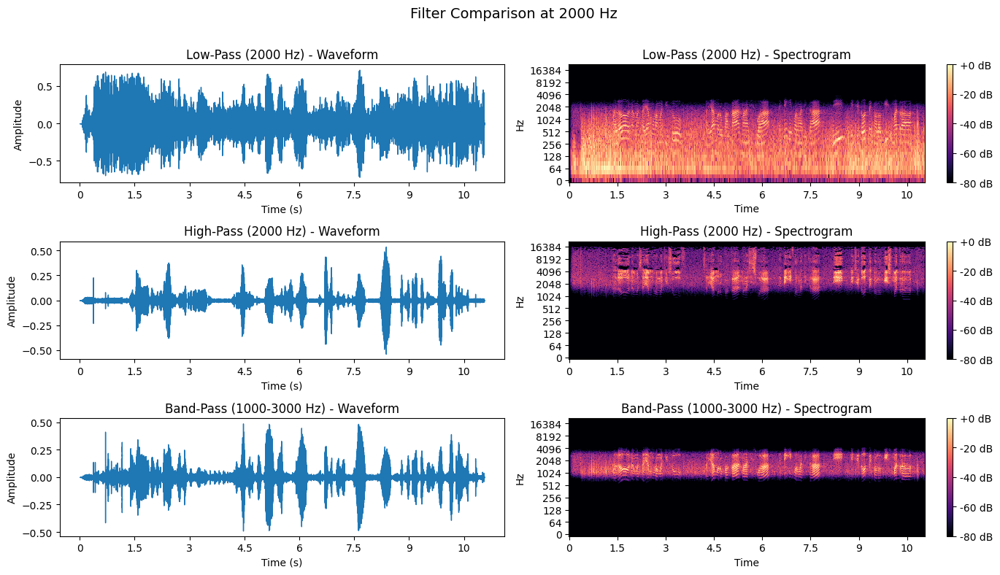


FILTERING COMPLETE


In [21]:
# ==========================================================
# JAWABAN SOAL 2 - Noise Reduction with Filtering
# ==========================================================

# ========================================
# 1. Load Audio
# ========================================
base_dir = Path.cwd()
audio_path = base_dir / "data" / "soal2.wav"

y, sr = librosa.load(audio_path, sr=None)

print("="*50)
print("AUDIO INFORMATION")
print("="*50)
print(f"File Path       : {audio_path}")
print(f"Sample Rate     : {sr} Hz")
print(f"Duration        : {librosa.get_duration(y=y, sr=sr):.2f} s")
print(f"Samples         : {len(y)}")
print(f"Channels        : {'Mono' if len(y.shape) == 1 else 'Stereo'}")
print("="*50)

# ========================================
# 2. Original Audio Visualization
# ========================================
print("\nMenampilkan waveform dan spectrogram (original)...")

# Membuat figure dengan 1 baris dan 2 kolom
fig, axes = plt.subplots(1, 2, figsize=(14, 4))

# --- Waveform ---
librosa.display.waveshow(y, sr=sr, ax=axes[0])
axes[0].set_title("Original Audio Waveform")
axes[0].set_xlabel("Time (s)")
axes[0].set_ylabel("Amplitude")

# --- Spectrogram ---
S = np.abs(librosa.stft(y))
S_db = librosa.amplitude_to_db(S, ref=np.max)
img = librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='log', cmap='magma', ax=axes[1])
axes[1].set_title("Original Audio Spectrogram")
fig.colorbar(img, ax=axes[1], format='%+2.0f dB')

plt.tight_layout()
plt.show()

print("\n" + "="*50)
print("ORIGINAL AUDIO PLAYBACK")
print("="*50)
display(ipd.Audio(y, rate=sr))


# ========================================
# 3. Filter Function
# ========================================
def butter_filter(y, sr, btype, cutoff):
    """General Butterworth filter for low, high, or band type"""
    nyq = 0.5 * sr
    if btype == 'band':
        low, high = np.array(cutoff) / nyq
        b, a = butter(5, [low, high], btype='band')
    else:
        normal_cutoff = cutoff / nyq
        b, a = butter(5, normal_cutoff, btype=btype)
    return filtfilt(b, a, y)

# ========================================
# 4. Apply Filters (Default Settings)
# ========================================
print("\n" + "="*50)
print("FILTER APPLICATION (Default Cutoffs)")
print("="*50)

low_pass = butter_filter(y, sr, 'low', 1000)
high_pass = butter_filter(y, sr, 'high', 1000)
band_pass = butter_filter(y, sr, 'band', (300, 3000))

# Playback hasil filter
print("\n▶ Low-Pass Filter (1000 Hz)")
display(ipd.Audio(low_pass, rate=sr))

print("\n▶ High-Pass Filter (1000 Hz)")
display(ipd.Audio(high_pass, rate=sr))

print("\n▶ Band-Pass Filter (300–3000 Hz)")
display(ipd.Audio(band_pass, rate=sr))

# ========================================
# 5. Filter Comparison Visualization
# ========================================
fig, axes = plt.subplots(3, 2, figsize=(16, 8))
filters = {
    "Low-Pass (1000 Hz)": low_pass,
    "High-Pass (1000 Hz)": high_pass,
    "Band-Pass (300–3000 Hz)": band_pass
}

for i, (title, data) in enumerate(filters.items()):
    # Waveform
    librosa.display.waveshow(data, sr=sr, ax=axes[i, 0])
    axes[i, 0].set_title(f"{title} - Waveform")
    axes[i, 0].set_xlabel("Time (s)")
    axes[i, 0].set_ylabel("Amplitude")

    # Spectrogram
    S = np.abs(librosa.stft(data))
    S_db = librosa.amplitude_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='log', ax=axes[i, 1], cmap='magma')
    axes[i, 1].set_title(f"{title} - Spectrogram")
    fig.colorbar(img, ax=axes[i, 1], format='%+2.0f dB')

plt.tight_layout()
plt.show()

# ========================================
# 6. Frequency Variation Experiment (Playback Only - Optimized)
# ========================================
cutoff_values = [500, 1000, 2000]

for cutoff in cutoff_values:
    print(f"\nTesting cutoff frequency: {cutoff} Hz")
    low_f = butter_filter(y, sr, 'low', cutoff)
    high_f = butter_filter(y, sr, 'high', cutoff)
    band_f = butter_filter(y, sr, 'band', (cutoff / 2, cutoff * 1.5))

    # Playback hasil filter
    print(f"\n▶ Low-Pass {cutoff} Hz")
    display(ipd.Audio(low_f, rate=sr))
    
    print(f"\n▶ High-Pass {cutoff} Hz")
    display(ipd.Audio(high_f, rate=sr))
    
    print(f"\n▶ Band-Pass {cutoff/2:.0f}-{cutoff*1.5:.0f} Hz")
    display(ipd.Audio(band_f, rate=sr))

    # --- Visualisasi dalam satu figure ---
    fig, axes = plt.subplots(3, 2, figsize=(14, 8))
    fig.suptitle(f"Filter Comparison at {cutoff} Hz", fontsize=14)

    filtered_audios = {
        f"Low-Pass ({cutoff} Hz)": low_f,
        f"High-Pass ({cutoff} Hz)": high_f,
        f"Band-Pass ({int(cutoff/2)}-{int(cutoff*1.5)} Hz)": band_f
    }

    for i, (title, data) in enumerate(filtered_audios.items()):
        # Waveform
        librosa.display.waveshow(data, sr=sr, ax=axes[i, 0], max_points=20000)
        axes[i, 0].set_title(f"{title} - Waveform")
        axes[i, 0].set_xlabel("Time (s)")
        axes[i, 0].set_ylabel("Amplitude")

        # Spectrogram
        S_db = librosa.amplitude_to_db(np.abs(librosa.stft(data)), ref=np.max)
        img = librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='log',
                                       ax=axes[i, 1], cmap='magma')
        axes[i, 1].set_title(f"{title} - Spectrogram")
        fig.colorbar(img, ax=axes[i, 1], format='%+2.0f dB')

    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()
    plt.close(fig)

print("\n" + "="*50)
print("FILTERING COMPLETE")
print("="*50)


### Analysis Section Soal 2

1. Dari recording yang sudah dilakukan dengan kipas angin nyala, ada beberapa jenis noise:  
jenis noise berasal dari faktor noise eksternal yakni suara kipas angin

2. Yang paling pas adalah di    
Band-Pass 1000-3000 Hz, karena bisa cut frek rendah serta tinggi untuk mencari letak suara kita yang pas berada dimana

3. Nilai cutoff yang memberikan hasil terbaik
Band-Pass 1000-3000 Hz, ini juga efektif di bandpass alasannya sama dengan nomor 2

4. Bagaimana kualitas suara (kejelasan ucapan) setelah proses filtering
tetap terdengar suara kipas noise nya, karena kemungkinan saya yang terlalu mendekatkan mic saya ke kipas yang menyebabkan filter tidak bisa bekerja secara maksimal, hanya di bandpass dengan range frek 1000-3000 Hz yang paling oke untuk menyaring suara saya dari suara noise walau masih ada sedikit suara noise dari kipas

## Soal 3: Pitch Shifting dan Audio Manipulation


Menampilkan perbandingan waveform dan spectrogram (Original vs Chipmunk)...


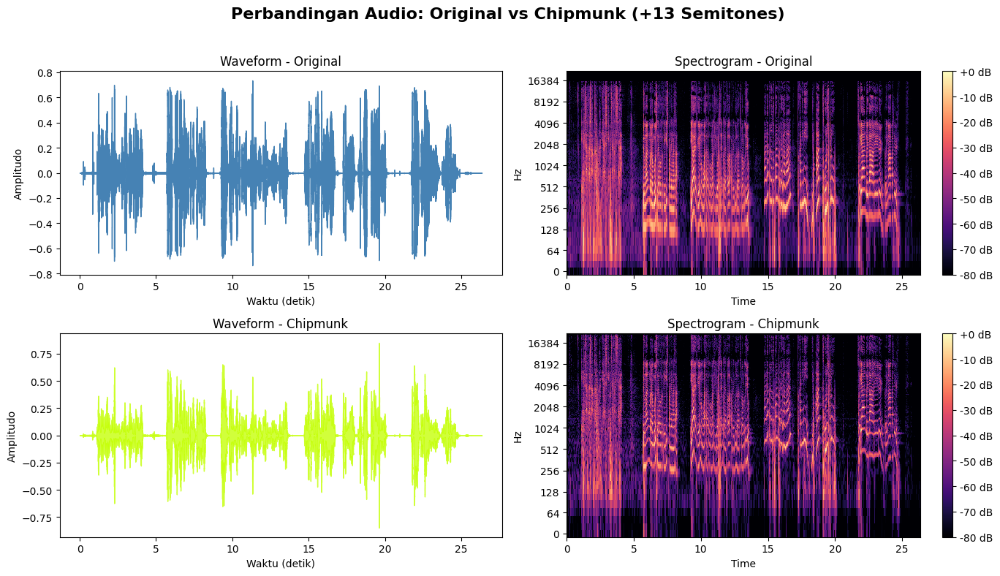


AUDIO PLAYBACK
▶ Original Audio:



▶ Mixed Audio (Original + Chipmunk Overlay)



▶ Audio Pitch +7 Semitone



▶ Audio Pitch +13 Semitone



▶ Combined (Overlay: +7 and +13 together)


In [30]:
# ==========================================================
# JAWABAN SOAL 3 - Pitch Shifting (Chipmunk Effect)
# ==========================================================

# ========================================
# 1. Load and Process Audio
# ========================================
base_dir = Path.cwd()
audio_path = base_dir / "data" / "soal1.wav"

# Load original audio
y, sr = librosa.load(audio_path, sr=None)

# Apply pitch shift (+13 semitones)
chipmunk_shift = 13
y_chipmunk = librosa.effects.pitch_shift(y, sr=sr, n_steps=chipmunk_shift)

# ========================================
# 2. Visualization - Waveform & Spectrogram
# ========================================
print("\nMenampilkan perbandingan waveform dan spectrogram (Original vs Chipmunk)...")

fig, axs = plt.subplots(2, 2, figsize=(14, 8))
fig.suptitle("Perbandingan Audio: Original vs Chipmunk (+13 Semitones)", fontsize=16, fontweight="bold")

# ---- Original Audio ----
librosa.display.waveshow(y, sr=sr, ax=axs[0, 0], color="#4682B4")
axs[0, 0].set_title("Waveform - Original", fontsize=12)
axs[0, 0].set_xlabel("Waktu (detik)")
axs[0, 0].set_ylabel("Amplitudo")

S_orig = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
img1 = librosa.display.specshow(S_orig, sr=sr, x_axis="time", y_axis="log", cmap="magma", ax=axs[0, 1])
axs[0, 1].set_title("Spectrogram - Original", fontsize=12)
fig.colorbar(img1, ax=axs[0, 1], format="%+2.0f dB")

# ---- Chipmunk Audio ----
librosa.display.waveshow(y_chipmunk, sr=sr, ax=axs[1, 0], color="#C3FF00C4")
axs[1, 0].set_title("Waveform - Chipmunk", fontsize=12)
axs[1, 0].set_xlabel("Waktu (detik)")
axs[1, 0].set_ylabel("Amplitudo")

S_chip = librosa.amplitude_to_db(np.abs(librosa.stft(y_chipmunk)), ref=np.max)
img2 = librosa.display.specshow(S_chip, sr=sr, x_axis="time", y_axis="log", cmap="magma", ax=axs[1, 1])
axs[1, 1].set_title("Spectrogram - Chipmunk", fontsize=12)
fig.colorbar(img2, ax=axs[1, 1], format="%+2.0f dB")

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# ========================================
# 3. Audio Playback
# ========================================
print("\n" + "="*50)
print("AUDIO PLAYBACK")
print("="*50)
print("▶ Original Audio:")
display(ipd.Audio(y, rate=sr))

# ========================================
# 4. Proses Penggabungan Audio
# ========================================
min_len = min(len(y), len(y_chipmunk))
combined_mix = y[:min_len] + y_chipmunk[:min_len]

# Normalisasi biar tidak clipping
combined_mix = combined_mix / np.max(np.abs(combined_mix))

# Playback hasil campuran
print("\n▶ Mixed Audio (Original + Chipmunk Overlay)")
display(ipd.Audio(combined_mix, rate=sr))

# Gabungan Auido Antara Audio Pitch 7 dan Audio Pitch 13
# Buat dua versi pitch shift
y_pitch7 = librosa.effects.pitch_shift(y, sr=sr, n_steps=7)
y_pitch13 = librosa.effects.pitch_shift(y, sr=sr, n_steps=13)

# Playback hasil individual
print("\n▶ Audio Pitch +7 Semitone")
display(ipd.Audio(y_pitch7, rate=sr))

print("\n▶ Audio Pitch +13 Semitone")
display(ipd.Audio(y_pitch13, rate=sr))

min_len = min(len(y_pitch7), len(y_pitch13))
combined_overlay = y_pitch7[:min_len] + y_pitch13[:min_len]

# Normalisasi agar tidak clipping
combined_overlay = combined_overlay / np.max(np.abs(combined_overlay))

print("\n▶ Combined (Overlay: +7 and +13 together)")
display(ipd.Audio(combined_overlay, rate=sr))


### Analysis Section Soal 3

Pada proses ini, saya melakukan pitch shifting pada audio dengan menaikkan nada sebesar +13 semitone menggunakan fungsi librosa.effects.pitch_shift(), di mana parameter n_steps menentukan seberapa jauh pergeseran nada dilakukan dan sr sebagai sample rate menjaga kecepatan playback tetap stabil. Hasil visual menunjukkan perbedaan yang jelas antara audio asli dan versi chipmunk: pada waveform, pola amplitudo masih serupa tetapi durasi dan distribusi energi tampak sedikit berubah, sedangkan pada spectrogram, warna dan pola frekuensi berpindah ke rentang yang lebih tinggi—menandakan bahwa suara menjadi lebih “nyaring” dan memiliki energi lebih kuat di frekuensi menengah hingga tinggi. Secara kualitas, hasil pitch shifting membuat suara terdengar seperti karakter chipmunk: lebih tajam, ringan, dan ceria, meskipun kejelasan artikulasi sedikit berkurang karena pergeseran frekuensi tersebut menyingkirkan sebagian resonansi alami dari suara aslinya.

## Soal 4: Audio Processing Chain

Loaded file: c:\Users\muham\OneDrive\Desktop\sistem-teknologi-multimedia-122140193\worksheet3\data\chipmunk.wav
Sample Rate: 44100 Hz
Duration: 26.35s

Processing pipeline running...
Final processed file saved at: c:\Users\muham\OneDrive\Desktop\sistem-teknologi-multimedia-122140193\worksheet3\data\chipmunk_final.wav

Visualizing result...


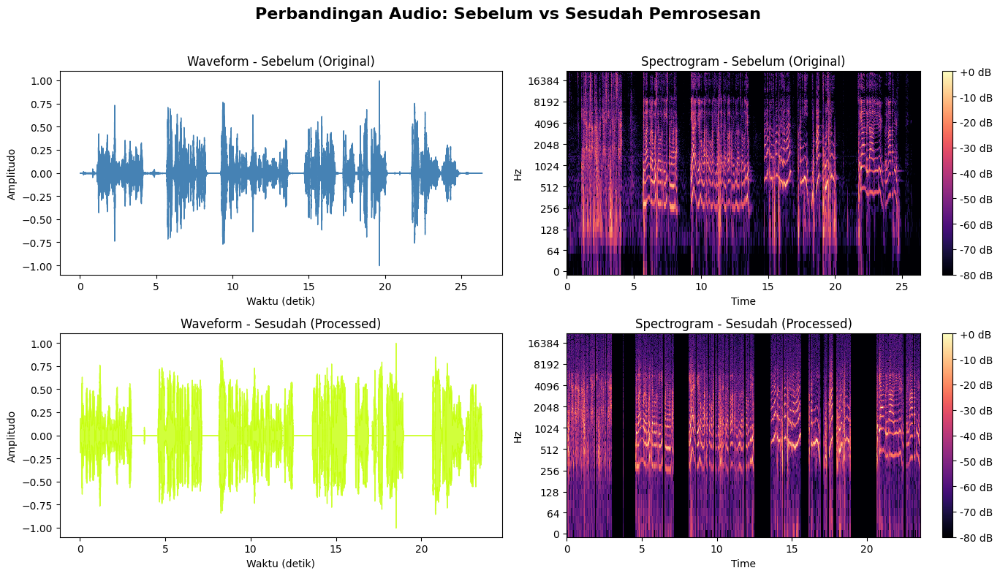

In [38]:
# ==========================================================
# JAWABAN SOAL 4 - Audio Processing Chain
# ==========================================================

# ========================================
# 1. Load Audio
# ========================================
base_dir = Path.cwd()
input = base_dir / "data" / "chipmunk.wav"
output = base_dir / "data" / "chipmunk_final.wav"

y, sr = librosa.load(input, sr=None)
print(f"Loaded file: {input}\nSample Rate: {sr} Hz\nDuration: {librosa.get_duration(y=y, sr=sr):.2f}s")

# ========================================
# 2. Audio Processing Utilities
# ========================================

def band_eq(audio, sr, low=300, high=6000, order=4):
    """Simple band EQ using Butterworth filter"""
    nyq = 0.5 * sr
    b, a = butter(order, [low / nyq, high / nyq], btype="band")
    return filtfilt(b, a, audio)

def dynamic_fade(audio, start_gain=0.8, end_gain=1.0, boost=1.2):
    """Linear fade-in with global gain boost"""
    fade_curve = np.linspace(start_gain, end_gain, len(audio))
    return audio * fade_curve * boost

def normalize_audio(audio):
    """Normalize to peak 0 dBFS"""
    peak = np.max(np.abs(audio))
    return audio / peak if peak > 0 else audio

def soft_compress(audio, threshold=0.2, ratio=4.0):
    """Basic soft-knee compressor"""
    mask = np.abs(audio) > threshold
    audio[mask] = np.sign(audio[mask]) * (threshold + (np.abs(audio[mask]) - threshold) / ratio)
    return audio

def gate_noise(audio, threshold=0.02):
    """Zero out samples below noise floor"""
    gated = np.where(np.abs(audio) < threshold, 0, audio)
    return gated

def remove_silence(audio, threshold=0.01):
    """Trim silence from start and end"""
    idx = np.where(np.abs(audio) > threshold)[0]
    return audio[idx[0]:idx[-1]] if len(idx) > 0 else audio

# ========================================
# 3. Processing Pipeline
# ========================================

print("\nProcessing pipeline running...")

processed = band_eq(y, sr)
processed = dynamic_fade(processed)
processed = normalize_audio(processed)
processed = soft_compress(processed)
processed = gate_noise(processed)
processed = remove_silence(processed)
processed = normalize_audio(processed)

# ========================================
# 4. Loudness Normalization (-16 LUFS equivalent)
# ========================================

target_lufs = -16.0
rms = np.sqrt(np.mean(processed ** 2))
current_db = 20 * np.log10(rms + 1e-9)
gain_db = target_lufs - current_db
gain = 10 ** (gain_db / 20)

final_audio = processed * gain

sf.write(output, final_audio, sr)
print(f"Final processed file saved at: {output}")

# ========================================
# 5. Visualization (Before vs After)
# ========================================

def visualize_audio(original, processed, sr):
    plt.figure(figsize=(14, 8))
    plt.suptitle("Perbandingan Audio: Sebelum vs Sesudah Pemrosesan", fontsize=16, fontweight="bold")

    # --- Waveform Original ---
    plt.subplot(2, 2, 1)
    librosa.display.waveshow(original, sr=sr, color="#4682B4")
    plt.title("Waveform - Sebelum (Original)")
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Amplitudo")

    # --- Spectrogram Original ---
    plt.subplot(2, 2, 2)
    D_orig = np.abs(librosa.stft(original))
    DB_orig = librosa.amplitude_to_db(D_orig, ref=np.max)
    librosa.display.specshow(DB_orig, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title("Spectrogram - Sebelum (Original)")

    # --- Waveform Processed ---
    plt.subplot(2, 2, 3)
    librosa.display.waveshow(processed, sr=sr, color="#C3FF00C4")
    plt.title("Waveform - Sesudah (Processed)")
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Amplitudo")

    # --- Spectrogram Processed ---
    plt.subplot(2, 2, 4)
    D_proc = np.abs(librosa.stft(processed))
    DB_proc = librosa.amplitude_to_db(D_proc, ref=np.max)
    librosa.display.specshow(DB_proc, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title("Spectrogram - Sesudah (Processed)")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

print("\nVisualizing result...")
visualize_audio(y, final_audio, sr)


### Analysis Section Soal 4

Setelah proses audio dijalankan, suara terdengar lebih seimbang bagian yang semula pelan jadi jelas, sedangkan bagian yang terlalu keras jadi lebih terkontrol. Efek dari compression dan normalize membuat volume lebih rata tanpa menghilangkan detail penting. Normalisasi peak hanya mengatur batas tertinggi sinyal agar tidak melebihi 0 dBFS, sedangkan normalisasi LUFS menyesuaikan tingkat kenyaringan sesuai persepsi telinga agar terdengar konsisten di berbagai perangkat. Hasil akhirnya, suara jadi lebih jernih, stabil, dan nyaman didengar, meski sedikit mengurangi dinamika alami. Secara keseluruhan, pengaturan loudness ini bikin hasilnya terasa lebih profesional dan rapi.

## Soal 5: Music Analysis dan Remix

Analyzing both songs...

Song A → Tempo: 119.7 BPM | Key: F# | Durasi: 77.4s
Song B → Tempo: 104.2 BPM | Key: G | Durasi: 175.9s

Remix selesai: c:\Users\muham\OneDrive\Desktop\sistem-teknologi-multimedia-122140193\worksheet3\data\remix_kebunku.wav

Visualizing Remix Output...


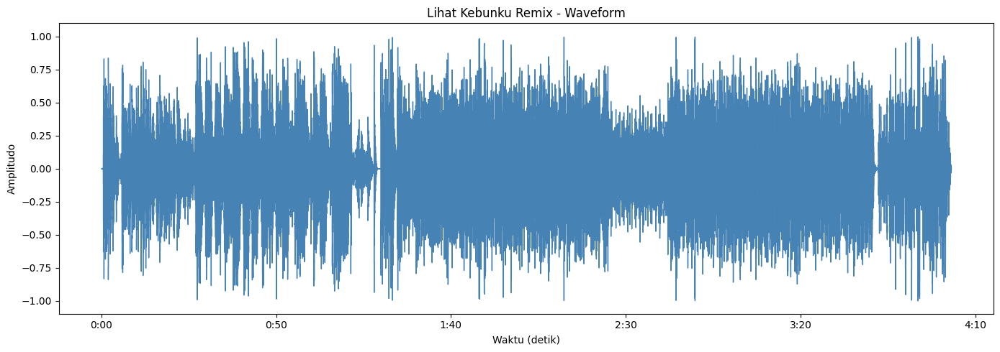

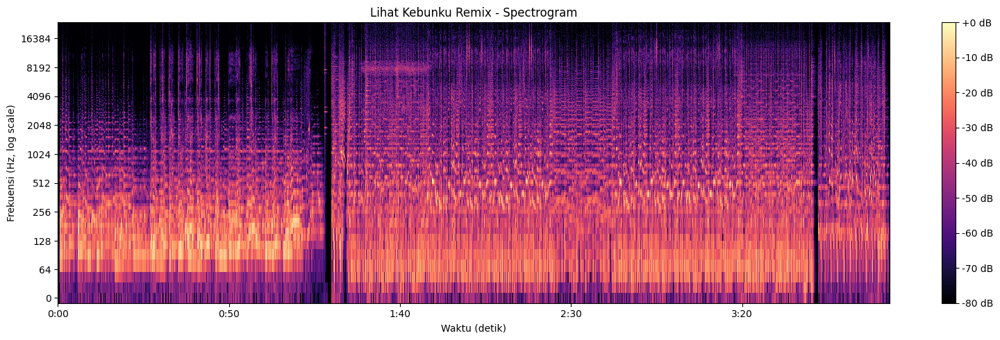

In [37]:
# ==========================================================
# JAWABAN SOAL 5 - Music Analysis dan Remix
# ==========================================================

# ========================================
# 1. Path Setup
# ========================================
base_dir = Path.cwd()
song_a = base_dir / "data" / "lihat-kebunku-dewasa.wav"
song_b = base_dir / "data" / "lihat-kebunku-anak2.wav"
output_file = base_dir / "data" / "remix_kebunku.wav"

# Remix Parameters
crossfade_sec = 4
offset_sec = 4
end_trim_sec = 2
key_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

# ========================================
# 2. Audio Analysis Functions
# ========================================
def analyze_audio(path):
    """Return waveform, sample rate, tempo (BPM), key, and duration."""
    y, sr = librosa.load(str(path), sr=None)
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
    tempo = float(tempo[0]) if np.ndim(tempo) > 0 else float(tempo)
    chroma = librosa.feature.chroma_cqt(y=y, sr=sr)
    key = key_names[int(np.argmax(np.sum(chroma, axis=1)))]
    duration = librosa.get_duration(y=y, sr=sr)
    return y, sr, tempo, key, float(duration)

def semitone_difference(src_key, target_key):
    """Return semitone difference between two musical keys."""
    return key_names.index(target_key) - key_names.index(src_key)

# ========================================
# 3. Audio Transformation Utilities
# ========================================
def adjust_tempo(y, src_tempo, target_tempo):
    """Apply time-stretching to match target tempo."""
    rate = target_tempo / src_tempo
    return librosa.effects.time_stretch(y, rate=rate)

def shift_pitch(y, sr, semitones):
    """Shift pitch by N semitones."""
    return librosa.effects.pitch_shift(y, sr=sr, n_steps=semitones)

def crossfade_audio(a, b):
    """Blend two audio segments with equal-length fade."""
    n = min(len(a), len(b))
    fade_in = np.linspace(0, 1, n)
    fade_out = 1 - fade_in
    return (a[:n] * fade_out) + (b[:n] * fade_in)

# ========================================
# 4. Processing Pipeline
# ========================================
print("Analyzing both songs...\n")

y1, sr1, tempo1, key1, dur1 = analyze_audio(song_a)
y2, sr2, tempo2, key2, dur2 = analyze_audio(song_b)

print(f"Song A → Tempo: {tempo1:.1f} BPM | Key: {key1} | Durasi: {dur1:.1f}s")
print(f"Song B → Tempo: {tempo2:.1f} BPM | Key: {key2} | Durasi: {dur2:.1f}s")

# Hitung parameter crossfade dalam sample
crossfade_samples = int(sr1 * crossfade_sec)
offset_samples = int(sr2 * offset_sec)
end_trim_samples = int(sr1 * end_trim_sec)

crossfade_samples = min(crossfade_samples, len(y1)-end_trim_samples, len(y2)-offset_samples)

# Ambil segmen akhir dan awal lagu
y1_end = y1[-(crossfade_samples + end_trim_samples):-end_trim_samples]
y2_start = y2[offset_samples : offset_samples + crossfade_samples]
y2_rest = y2[offset_samples + crossfade_samples :]

# Penyesuaian tempo dan nada di bagian transisi
mid_tempo = (tempo1 + tempo2) / 2
y1_adj = adjust_tempo(y1_end, tempo1, mid_tempo)
y2_adj = adjust_tempo(y2_start, tempo2, mid_tempo)

semitone_shift_val = semitone_difference(key1, key2)
y1_shifted = shift_pitch(y1_adj, sr1, semitone_shift_val)
y2_shifted = shift_pitch(y2_adj, sr1, 0)

# Crossfade untuk transisi halus
transition = crossfade_audio(y1_shifted, y2_shifted)

# Satukan hasil akhir
final_mix = np.concatenate([
    y1[:-(crossfade_samples + end_trim_samples)],
    transition,
    y2_rest
])

sf.write(output_file, final_mix, sr1)
print(f"\nRemix selesai: {output_file}")

# ========================================
# 5. Visualization
# ========================================
def visualize_audio(y, sr, title):
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(y, sr=sr, color='steelblue')
    plt.title(f"{title} - Waveform")
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Amplitudo")
    plt.tight_layout()
    plt.show()

    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    plt.figure(figsize=(16, 5))
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"{title} - Spectrogram")
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Frekuensi (Hz, log scale)")
    plt.tight_layout()
    plt.show()

print("\nVisualizing Remix Output...")
visualize_audio(final_mix, sr1, "Lihat Kebunku Remix")


### Analysis Section Soal 5

Dalam proses remix lagu Lihat Kebunku, versi dewasa dan anak-anak digabung dengan menganalisis tempo, nada, dan durasi menggunakan Librosa. Kedua lagu disesuaikan temponya lewat time-stretching agar ritmenya seimbang, lalu nada dasarnya disejajarkan dengan pitch-shifting supaya transisi terdengar natural. Teknik crossfade selama empat detik dipakai untuk menyatukan bagian akhir lagu pertama dengan awal lagu kedua agar perpindahannya halus. Hasil akhirnya terlihat pada waveform dan spektrogram yang menunjukkan perpaduan frekuensi dari kedua versi, menciptakan remix yang lembut, selaras, dan enak didengar.

### Link Referensi

[Link ChatGPT](https://chatgpt.com/share/e/68f27384-8824-8006-815f-d4e7e153c7b6)    
[Link GitHub](https://github.com/muhamyusuf/sistem-teknologi-multimedia/tree/main/worksheet3)